In [1]:
import pandas as pd
import geopandas as gpd

In [2]:
#api to give state and date wise category of data
link = "https://api.covid19india.org/states_daily.json"

In [3]:
import urllib.request as ur
import json
#from pandas import json_normalize
from pandas.io.json import json_normalize
import pandas as pd

In [4]:
response = ur.urlopen(link)
data = json.loads(response.read())

In [5]:
confirmed_index = [i for i in range(len(data.get('states_daily'))) if 'Confirmed' in data.get('states_daily')[i].values()]

In [6]:
recovered_index = [i for i in range(len(data.get('states_daily'))) if 'Recovered' in data.get('states_daily')[i].values()]

In [7]:
deceased_index = [i for i in range(len(data.get('states_daily'))) if 'Deceased' in data.get('states_daily')[i].values()]

In [8]:
lst = [[key,data.get('states_daily')[0].get(key)] for key in data.get('states_daily')[0].keys() if key not in ['date','status']]

In [9]:
temp_df = pd.DataFrame(data=lst,columns=["state_code","case_count"])

In [10]:
final_df = pd.DataFrame()
for c in confirmed_index:
    lst = [[key,data.get('states_daily')[c].get(key)] for key in data.get('states_daily')[c].keys() if key not in ['date','status']]
    temp_df = pd.DataFrame(data=lst,columns=["state_code","case_count"])
    data_date = data.get('states_daily')[c].get('date')
    temp_df['date'] = data_date
    temp_df['status'] = 'confirmed'
    final_df = final_df.append(temp_df,ignore_index = True)
#     print("date done",data_date)

In [11]:
for c in recovered_index:
    lst = [[key,data.get('states_daily')[c].get(key)] for key in data.get('states_daily')[c].keys() if key not in ['date','status']]
    temp_df = pd.DataFrame(data=lst,columns=["state_code","case_count"])
    data_date = data.get('states_daily')[c].get('date')
    temp_df['date'] = data_date
    temp_df['status'] = 'recovered'
    final_df = final_df.append(temp_df,ignore_index = True)
#     print("date done",data_date)

In [12]:
for c in deceased_index:
    lst = [[key,data.get('states_daily')[c].get(key)] for key in data.get('states_daily')[c].keys() if key not in ['date','status']]
    temp_df = pd.DataFrame(data=lst,columns=["state_code","case_count"])
    data_date = data.get('states_daily')[c].get('date')
    temp_df['date'] = data_date
    temp_df['status'] = 'deceased'
    final_df = final_df.append(temp_df,ignore_index = True)
#     print("date done",data_date)

In [13]:
final_df['case_count'] = final_df['case_count'].astype(int)

In [14]:
#data to study the confirmed cases time series and predict the downfall
final_df_copy = final_df.copy()

In [15]:
final_df_copy['date'] = pd.to_datetime(final_df_copy['date'],format="%d-%b-%y")

In [16]:
final_df_to_plot = final_df_copy[final_df_copy['state_code'] == 'tt']

In [64]:
final_df_tt_confirmed = final_df_copy[(final_df_copy['status'] == 'confirmed') & (final_df_copy['state_code'] == 'tt')].copy()

In [65]:
final_df_tt_recovered = final_df_copy[(final_df_copy['status'] == 'recovered') & (final_df_copy['state_code'] == 'tt')].copy()

In [66]:
final_df_tt_death = final_df_copy[(final_df_copy['status'] == 'deceased') & (final_df_copy['state_code'] == 'tt')].copy()

In [17]:
import plotly.express as px

In [18]:
fig = px.line(final_df_to_plot, x='date', y='case_count',color='status',color_discrete_sequence=["red","green","grey"])
fig.update_xaxes(rangeslider_visible=True)
fig.show()

In [19]:
# reading the geometry file
states = gpd.read_file('IND_adm/states-final.shp')

In [21]:
import datetime

In [22]:
final_df_yest = final_df_copy[(final_df_copy.date == datetime.datetime(2020,6,26,0,0,0)) & (final_df_copy.status == "confirmed")]

In [23]:
# filter the total cases, as it skew the scale and goes to the data for mapping 
final_df_yest = final_df_yest[~(final_df_yest.state_code.isin(['tt','un']))]

In [24]:
# for mapping with matplitlib
states_join = states.merge(final_df_yest,on = "state_code")

In [25]:
states_join['case_count'] = states_join['case_count'].astype(int)

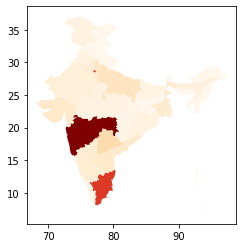

In [27]:
import matplotlib.pyplot as plt
# fig, ax = plt.subplots(1, 1)
# states_join.plot(column='case_count', ax=ax, legend=True)
states_join.plot(column='case_count',cmap='OrRd');

# Mapping with Folium

In [28]:
import os
import folium

In [29]:
import json
import requests

In [30]:
import json
#reading the geometry file as a json object
with open('IND_adm/states-final.geojson') as json_file:
    states_geom = json.load(json_file)

In [31]:
# adding count of cases to the geom file for hover pop up
for i in range(len(states_geom.get('features'))):
    states_geom['features'][i]['properties']['case_count'] = int(final_df_yest[final_df_yest.state_code == states_geom.get('features')[i].get('properties').get('state_code')].case_count)
   

In [32]:
final_df_yest['case_count'] = final_df_yest['case_count'].astype(int)

In [33]:
m = folium.Map(width=900,height=700,location = [20, 78], zoom_start=5)

choropleth = folium.Choropleth(
    geo_data=states_geom,
    data=final_df_yest,
    columns=['state_code', 'case_count'],
    key_on='feature.properties.state_code',
    fill_color='YlOrRd',
    name='covid cases',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Number of Cases',
    highlight=True
#     show=False,
).add_to(m)

# The underlying GeoJson and StepColormap objects are reachable
# print(type(choropleth.geojson))
# print(type(choropleth.color_scale))

folium.LayerControl(collapsed=False).add_to(m)
choropleth.geojson.add_child(folium.features.GeoJsonTooltip(['case_count'],labels=False))

m

In [162]:
#sample Mapping data from folium documentation
url = 'https://raw.githubusercontent.com/python-visualization/folium/master/examples/data'
state_geo = f'{url}/us-states.json'
state_unemployment = f'{url}/US_Unemployment_Oct2012.csv'
state_data = pd.read_csv(state_unemployment)

In [167]:
import json
import requests


url = 'https://raw.githubusercontent.com/python-visualization/folium/master/examples/data'
us_states = f'{url}/us-states.json'

geo_json_data = json.loads(requests.get(us_states).text)

In [168]:
m = folium.Map(location=[48, -102], zoom_start=3)

folium.Choropleth(
    geo_data=geo_json_data,
    name='choropleth',
    data=state_data,
    columns=['State', 'Unemployment'],
    key_on='feature.id',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Unemployment Rate (%)'
).add_to(m)

folium.LayerControl().add_to(m)

m

In [67]:
# data preperation for correlation between confirmed, deceased and recovered cases, and lockdown effects

# final_df_tt_confirmed.head()
# final_df_tt_recovered.head()
# final_df_tt_death.head()

# final_df_tt_confirmed.rename(columns={"case_count":"confirmed"},inplace=True)
# final_df_tt_recovered.rename(columns={"case_count":"recovered"},inplace=True)
# final_df_tt_death.rename(columns={"case_count":"deceased"},inplace=True)

final_df_tt_confirmed = final_df_tt_confirmed.reset_index()
final_df_tt_recovered =final_df_tt_recovered.reset_index()
final_df_tt_death = final_df_tt_death.reset_index()

final_df_merged = final_df_tt_confirmed.drop(["status"],axis=1)

In [68]:
final_df_merged['recovered']=final_df_tt_recovered.case_count
final_df_merged['deceased']=final_df_tt_death.case_count

In [69]:
final_df_merged.drop(["index"],axis=1,inplace=True)

In [74]:
final_df_merged.tail()

,state_code,case_count,date,recovered,deceased
100,tt,13560,2020-06-22,10879,312
101,tt,15656,2020-06-23,10462,468
102,tt,16868,2020-06-24,13089,424
103,tt,18205,2020-06-25,13983,401
104,tt,18255,2020-06-26,10246,381


In [344]:
final_df_merged = pd.to_datetime(final_df_merged['date'],format="%d-%b-%y")

,state_code,case_count,date,recovered,deceased
0,tt,81,2020-03-14,9,2
1,tt,27,2020-03-15,4,0
2,tt,15,2020-03-16,1,0
3,tt,11,2020-03-17,1,1
4,tt,37,2020-03-18,0,0


In [36]:
# link for daily testing state wise
testing_data_link = "https://api.covid19india.org/state_test_data.json"
total_time_series = "https://api.covid19india.org/data.json"

In [37]:
test_response = ur.urlopen(testing_data_link)
test_data_statewise = json.loads(test_response.read())

In [38]:
test_data = pd.json_normalize(test_data_statewise['states_tested_data'])

In [39]:
test_data.columns

Index(['coronaenquirycalls', 'cumulativepeopleinquarantine', 'negative',
       'numcallsstatehelpline', 'numicubeds', 'numisolationbeds',
       'numventilators', 'peopleinicu', 'peopleonventilators',
       'populationncp2019projection', 'positive', 'source1', 'source2',
       'state', 'tagpeopleinquarantine', 'tagtotaltested',
       'testpositivityrate', 'testspermillion', 'testsperpositivecase',
       'testsperthousand', 'totaln95masks', 'totalpeoplecurrentlyinquarantine',
       'totalpeoplereleasedfromquarantine', 'totalppe', 'totaltested',
       'unconfirmed', 'updatedon', '_d5fpr'],
      dtype='object')

In [40]:
test_data = test_data[['updatedon','totaltested','state','negative','testsperpositivecase','testsperthousand', 'totaln95masks','unconfirmed']]

In [41]:
time_series_response = ur.urlopen(total_time_series)
time_series_national = json.loads(time_series_response.read())

In [42]:
time_series_national.keys()

dict_keys(['cases_time_series', 'statewise', 'tested'])

In [43]:
time_series = pd.json_normalize(time_series_national['cases_time_series'])

In [57]:
time_series.head()

,dailyconfirmed,dailydeceased,dailyrecovered,date,totalconfirmed,totaldeceased,totalrecovered
0,1,0,0,30 January,1,0,0
1,0,0,0,31 January,1,0,0
2,0,0,0,01 February,1,0,0
3,1,0,0,02 February,2,0,0
4,1,0,0,03 February,3,0,0


In [44]:
tested_time_series = pd.json_normalize(time_series_national['tested'])

In [45]:
tested_time_series.tail()

,individualstestedperconfirmedcase,positivecasesfromsamplesreported,samplereportedtoday,source,source1,testedasof,testpositivityrate,testsconductedbyprivatelabs,testsperconfirmedcase,testspermillion,totalindividualstested,totalpositivecases,totalsamplestested,updatetimestamp
104,,,187223,https://t.me/Covid19india_Auxiliary_Test_Data/610,https://twitter.com/ICMRDELHI/status/127527761...,22/06/2020,,,,5355,,,7137716,23/06/2020 09:00:00
105,,,215195,https://twitter.com/ICMRDELHI/status/127563260...,https://t.me/Covid19india_Auxiliary_Test_Data/628,23/06/2020,,,,5516,,,7352911,24/06/2020 09:00:00
106,,,207871,https://twitter.com/ICMRDELHI/status/127599592...,,24/06/2020,,,,5672,,,7560782,25/06/2020 09:00:00
107,,,215446,https://twitter.com/ICMRDELHI/status/127635689...,,25/06/2020,,,,5834,,,7776228,26/06/2020 09:00:00
108,,,220479,https://twitter.com/ICMRDELHI/status/127672005...,https://t.me/Covid19india_Auxiliary_Test_Data/686,26/06/2020,,,,5999,,,7996707,27/06/2020 09:00:00


In [46]:
import plotly.graph_objects as go


In [85]:
# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=time_series.date, y=time_series.totalconfirmed,
                    name='total confirmed',
                    line=dict(color='firebrick', width=2)))
fig.add_trace(go.Scatter(x=time_series.date, y=time_series.totalrecovered,
                    name='total recovered',
                    line=dict(color='green', width=2)))
fig.add_trace(go.Scatter(x=time_series.date, y=time_series.totaldeceased,
                    name='total deceased',
                    line=dict(color='grey', width=1)))
fig.show()
fig.write_image("covid-cases-india.png",width=600, height=350, scale=2)

In [86]:
global_mobility = pd.read_csv("Global_Mobility_Report.csv")

/Users/rohitsingh/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3057: DtypeWarning:

Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.



In [59]:
global_mobility_india = global_mobility[(global_mobility.country_region_code == 'IN') & (global_mobility.sub_region_1.isnull())].copy()

In [62]:
global_mobility_india.head()

,country_region_code,country_region,sub_region_1,sub_region_2,iso_3166_2_code,census_fips_code,date,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline
100951,IN,India,NaN,NaN,NaN,NaN,2020-02-15,1.0,2.0,3.0,3.0,5.0,0.0
100952,IN,India,NaN,NaN,NaN,NaN,2020-02-16,2.0,2.0,3.0,2.0,0.0,0.0
100953,IN,India,NaN,NaN,NaN,NaN,2020-02-17,-1.0,1.0,3.0,1.0,4.0,0.0
100954,IN,India,NaN,NaN,NaN,NaN,2020-02-18,0.0,2.0,4.0,2.0,3.0,0.0
100955,IN,India,NaN,NaN,NaN,NaN,2020-02-19,0.0,2.0,1.0,1.0,4.0,1.0


In [61]:
global_mobility_india['date'] = pd.to_datetime(global_mobility_india['date'],format="%Y-%m-%d")

In [88]:
# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=global_mobility_india.date, y=global_mobility_india.retail_and_recreation_percent_change_from_baseline,
                    name='Retail and Recreation',
                    line=dict(color='firebrick', width=2.5)))
fig.add_trace(go.Scatter(x=global_mobility_india.date, y=global_mobility_india.grocery_and_pharmacy_percent_change_from_baseline,
                    name='Grocery and Pharmacy',
                    line=dict(color='green', width=2)))
fig.add_trace(go.Scatter(x=global_mobility_india.date, y=global_mobility_india.parks_percent_change_from_baseline,
                    name='Parks',
                    line=dict(color='grey', width=1)))
fig.add_trace(go.Scatter(x=global_mobility_india.date, y=global_mobility_india.transit_stations_percent_change_from_baseline,
                    name='Transit Stations',
                    line=dict(color='blue', width=1)))
fig.add_trace(go.Scatter(x=global_mobility_india.date, y=global_mobility_india.workplaces_percent_change_from_baseline,
                    name='Work Places',
                    line=dict(color='purple', width=2)))
fig.add_trace(go.Scatter(x=global_mobility_india.date, y=global_mobility_india.residential_percent_change_from_baseline,
                    name='Residential',
                    line=dict(color='black', width=1)))
fig.update_layout(
    title="% change in Mobility from baseline - India",
    xaxis_title="date",
    yaxis_title="% change",
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)
fig.show()
fig.write_image("india-people-mobility-trend.png", width=1000, height=600, scale=2)

In [91]:
# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=final_df_merged.date, y=final_df_merged.case_count,
                    name='Total confirmed cases',
                    line=dict(color='firebrick', width=2)))
fig.add_trace(go.Scatter(x=final_df_merged.date, y=final_df_merged.recovered,
                    name='Total recovered',
                    line=dict(color='green', width=2)))
fig.add_trace(go.Scatter(x=final_df_merged.date, y=final_df_merged.deceased,
                    name='Total deceased',
                    line=dict(color='grey', width=1)))
fig.update_layout(
    title="Covid cases daily change - India",
    xaxis_title="date",
    yaxis_title="numbers",
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)
fig.show()

fig.write_image("covid-cases-india.png",width=1000, height=600, scale=2)

In [89]:
final_df_merged.head()

,state_code,case_count,date,recovered,deceased
0,tt,81,2020-03-14,9,2
1,tt,27,2020-03-15,4,0
2,tt,15,2020-03-16,1,0
3,tt,11,2020-03-17,1,1
4,tt,37,2020-03-18,0,0
